# Business understanding

Generator planet 
- format wejściowy plików:  1920px/1080px
- format wyjściowy plików:  256px/256px

In [2]:
# import niezbednych bibliotek
import os
from matplotlib import pyplot as plt
import numpy as np
from PIL import Image

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

from sklearn.preprocessing import LabelEncoder
from keras.models import load_model

In [2]:
# wersja tensorflow
print('tensorflow ver: ', tf.__version__)
print('keras ver     : ', tf.keras.__version__)

tensorflow ver:  2.10.1
keras ver     :  2.10.0


# Data understanding and data preparation

Dataset zrobiony z modeli udostępnionych przez NASA na stronie: nasa.gov
- 12 planet/gwiazd
- 100 zdjęć na planetę/gwiazde

wybór - 4 planet/gwiazd

In [3]:
dir_directory_path = './DATA/v1'

images_data = []
images_labels = []
    
subfolders = [ f.path for f in os.scandir(dir_directory_path) if f.is_dir() ]

for dir_path in subfolders:
    print('Loading data from folder', dir_path.replace("\\", "/"))

    if dir_path.find('earth') == -1 and dir_path.find('sun') == -1 and dir_path.find('mars') == -1: 
        continue
    
    dataset = tf.keras.preprocessing.image_dataset_from_directory(
                dir_path, 
                label_mode=None, 
                image_size=(256, 456), 
                batch_size=32,
                #color_mode='grayscale'
            )
    
    for i in dataset:
        for ii in i:            
            new_img = ii[0:256, 100: 356]
            images_data.append(new_img)
            images_labels.append(dir_path.replace(dir_directory_path, '').replace('\\',''))
                        
images_data = np.asarray(images_data)
images_labels = np.asarray(images_labels)

new_images_data = []
new_images_labels = []

for idx in range(0, images_data.shape[0]):
    img = Image.fromarray(np.uint8(images_data[idx]))
    class_name = images_labels[idx]
    
    new_images_data.append(np.asarray(img))
    new_images_labels.append(class_name)
    
    for i in range(180,360,180):
        rotated_img = img.rotate(i)
        new_images_data.append(np.asarray(rotated_img))
        new_images_labels.append(class_name)
                        
images_data = np.asarray(new_images_data)
images_labels = np.asarray(new_images_labels)        

label_encoder = LabelEncoder()
images_labels_num = label_encoder.fit_transform(images_labels)

print()
print('Shapes:')
print('images_labels      :', images_labels.shape)
print('-----------------------------')
print('images_data        :', images_data.shape)
print('images_labels_num  :', images_labels_num.shape)

Loading data from folder ./DATA/v1/ceres
Loading data from folder ./DATA/v1/earth
Found 100 files belonging to 1 classes.
Loading data from folder ./DATA/v1/earth_moon
Found 100 files belonging to 1 classes.
Loading data from folder ./DATA/v1/eris
Loading data from folder ./DATA/v1/hamuea
Loading data from folder ./DATA/v1/jupiter
Loading data from folder ./DATA/v1/makemake
Loading data from folder ./DATA/v1/mars
Found 100 files belonging to 1 classes.
Loading data from folder ./DATA/v1/mercury
Loading data from folder ./DATA/v1/pluto
Loading data from folder ./DATA/v1/sun
Found 100 files belonging to 1 classes.
Loading data from folder ./DATA/v1/venus

Shapes:
images_labels      : (800,)
-----------------------------
images_data        : (800, 256, 256, 3)
images_labels_num  : (800,)


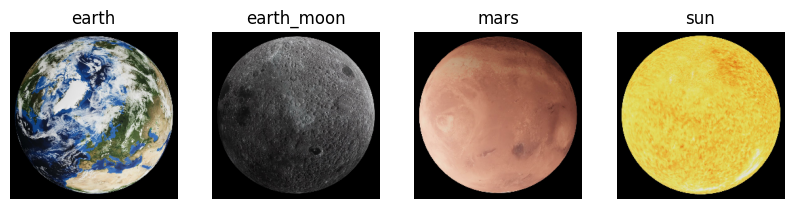

In [4]:
np.random.seed(100)

idx = 0
fig = plt.figure(figsize=(10, 10))
for i in np.unique(images_labels_num):    
    idx += 1
    class_position = np.where(images_labels_num  == i)[0]
    class_position = np.random.choice(class_position)
    plt.subplot(4, 4, idx)
    plt.imshow(images_data[class_position] / 255.)
    plt.title(images_labels[class_position])    
    plt.axis('off')
plt.show()
plt.close(fig)    

In [5]:
train_images = images_data
train_images = (train_images - 127.5) / 127.5  # Normalize the images to [-1, 1]

train_images.shape

(800, 256, 256, 3)

# Modeling

In [6]:
# latent dimension of the random noise
LATENT_DIM = 100 
# weight initializer for G per DCGAN paper
WEIGHT_INIT = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02) 
# number of channels, 1 for gray scale and 3 for color images
CHANNELS = 3 # UPDATED from 1

In [7]:
def build_generator(image_size):
    
    size = int(image_size / 4)
    
    # create a Keras Sequential model 
    model = Sequential(name='generator')

    # prepare for reshape: FC => BN => RN layers, note: input shape defined in the 1st Dense layer  
    model.add(layers.Dense(size * size * 256, input_dim=LATENT_DIM))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(0.2))
    
    # 1D => 3D: reshape the output of the previous layer 
    model.add(layers.Reshape((size, size, 256)))

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding="same", use_bias=False, kernel_initializer=WEIGHT_INIT))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding="same", use_bias=False, kernel_initializer=WEIGHT_INIT))
    model.add(layers.BatchNormalization())    
    model.add(layers.LeakyReLU())

    # last layer 
    model.add(layers.Conv2DTranspose(CHANNELS, (5, 5), strides=(2, 2), padding="same", use_bias=False, activation="tanh"))
        
    return model     


# build the generator model
generator = build_generator(256) 
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 1048576)           105906176 
                                                                 
 batch_normalization (BatchN  (None, 1048576)          4194304   
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 1048576)           0         
                                                                 
 reshape (Reshape)           (None, 64, 64, 256)       0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 64, 64, 128)      819200    
 nspose)                                                         
                                                                 
 batch_normalization_1 (Batc  (None, 64, 64, 128)      51

c:\APLIKACJE\PyDataScience\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.
  warnings.warn(


In [8]:
def build_discriminator(height, width, depth, alpha=0.2):
    # create a Keras Sequential model
    model = Sequential(name='discriminator')
    input_shape = (height, width, depth)

    # 1. first set of CONV => BN => leaky ReLU layers
    model.add(layers.Conv2D(64, (5, 5), padding="same", strides=(2, 2), input_shape=input_shape))
    #model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=alpha))
    model.add(layers.Dropout(0.3))
    
    # 2. second set of CONV => BN => leacy ReLU layers
    model.add(layers.Conv2D(128, (5, 5), padding="same", strides=(2, 2)))
    #model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=alpha))
    model.add(layers.Dropout(0.3))
    
    # flatten and apply dropout
    model.add(layers.Flatten())
    #model.add(layers.Dropout(0.3))
    model.add(layers.Dense(1, activation="sigmoid"))

    # return the discriminator model
    return model


# build the discriminator model
discriminator = build_discriminator(256, 256, 3) 
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 64)      4864      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 128, 128, 64)      0         
                                                                 
 dropout (Dropout)           (None, 128, 128, 64)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 128)       204928    
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 64, 64, 128)       0         
                                                                 
 dropout_1 (Dropout)         (None, 64, 64, 128)       0         
                                                                 
 flatten (Flatten)           (None, 524288)          

In [9]:
class DCGAN(keras.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super().__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_loss_metric = keras.metrics.Mean(name="d_loss")
        self.g_loss_metric = keras.metrics.Mean(name="g_loss")

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn

    @property
    def metrics(self):
        return [self.d_loss_metric, self.g_loss_metric]

    def train_step(self, real_images):

        batch_size = tf.shape(real_images)[0]
        noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # Step 1. Train the discriminator with both real images (label as 1) and fake images (classified as label as 0) 
        with tf.GradientTape() as tape:
            # Compute discriminator loss on real images
            pred_real = self.discriminator(real_images, training=True)
            real_labels = tf.ones((batch_size, 1))
            # UPDATED: apply one-sided label smoothing to real labels
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels)) 
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # Compute discriminator loss on fake images
            fake_images = self.generator(noise)
            pred_fake = self.discriminator(fake_images, training=True)
            fake_labels = tf.zeros((batch_size, 1))
            # UPDATED: add random noise to fake labels - not needed
            # fake_labels += 0.05 * tf.random.uniform(tf.shape(fake_labels)) 
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake)/2
        # Compute discriminator gradients
        grads = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # Update discriminator weights
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_variables))

        # Step 2. Train the generator (do not update weights of the discriminator)
        misleading_labels = tf.ones((batch_size, 1)) # G wants D to think the fake images are real (label as 1)

        with tf.GradientTape() as tape:
            fake_images = self.generator(noise, training=True)
            pred_fake = self.discriminator(fake_images, training=True)
            g_loss = self.loss_fn(misleading_labels, pred_fake)
        # Compute generator gradients
        grads = tape.gradient(g_loss, self.generator.trainable_variables)
        # Update generator wieghts
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_variables))

        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {"d_loss": self.d_loss_metric.result(), "g_loss": self.g_loss_metric.result()}     

In [13]:
class GANMonitor(keras.callbacks.Callback):
    def __init__(self, num_img=3, latent_dim=100):
        self.num_img = num_img
        self.latent_dim = latent_dim

        # Create random noise seed for visualization during traing
        self.seed = tf.random.normal([16, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        generated_images = self.model.generator(self.seed)
        generated_images = (generated_images * 127.5) + 127.5
        generated_images.numpy()

        fig = plt.figure(figsize=(11, 11))
        for i in range(self.num_img):
            plt.subplot(4, 4, i+1)
            img = keras.utils.array_to_img(generated_images[i]) 
            plt.imshow(img)
            plt.axis('off')
        plt.savefig('./results_256/S{:03d}_E{:03d}.jpg'.format(SESJA, epoch + 1)) 
        if epoch == 0 or epoch % 10 == 0:
            plt.show()
        plt.close(fig)
                
        for i in range(self.num_img):
            fig = plt.figure(figsize=(3, 3))
            img = keras.utils.array_to_img(generated_images[i]) 
            plt.imshow(img)
            plt.axis('off')
            plt.savefig('./results_256_v2/images/S{:03d}_E{:03d}_IMG{:03d}.jpg'.format(SESJA, epoch + 1, i + 1)) 
            plt.close(fig)
            
        if epoch % 10 == 0:
            self.model.generator.save('./results_256_v2/generator_256_S{:03d}_E{:03d}_.h5'.format(SESJA, epoch + 1))

    def on_train_end(self, logs=None):
        self.model.generator.save('./results_256_v2/generator_256_S{:03d}.h5'.format(SESJA))

# Evaluation

In [12]:
#from keras.models import load_model
#generator = load_model('./results_256/generator_256.h5')

In [11]:
dcgan = DCGAN(discriminator=discriminator, generator=generator, latent_dim=LATENT_DIM)

D_LR = 0.0001 # UPDATED: discriminator learning rate
G_LR = 0.0003 # UPDATED: generator learning rate

dcgan.compile(
    d_optimizer=keras.optimizers.Adam(learning_rate=D_LR, beta_1 = 0.5),
    g_optimizer=keras.optimizers.Adam(learning_rate=G_LR, beta_1 = 0.5),  
    loss_fn=keras.losses.BinaryCrossentropy(),
)

Epoch 1/250
25/25 [==============================] - ETA: 0s - d_loss: 4.5345 - g_loss: 3.2078 

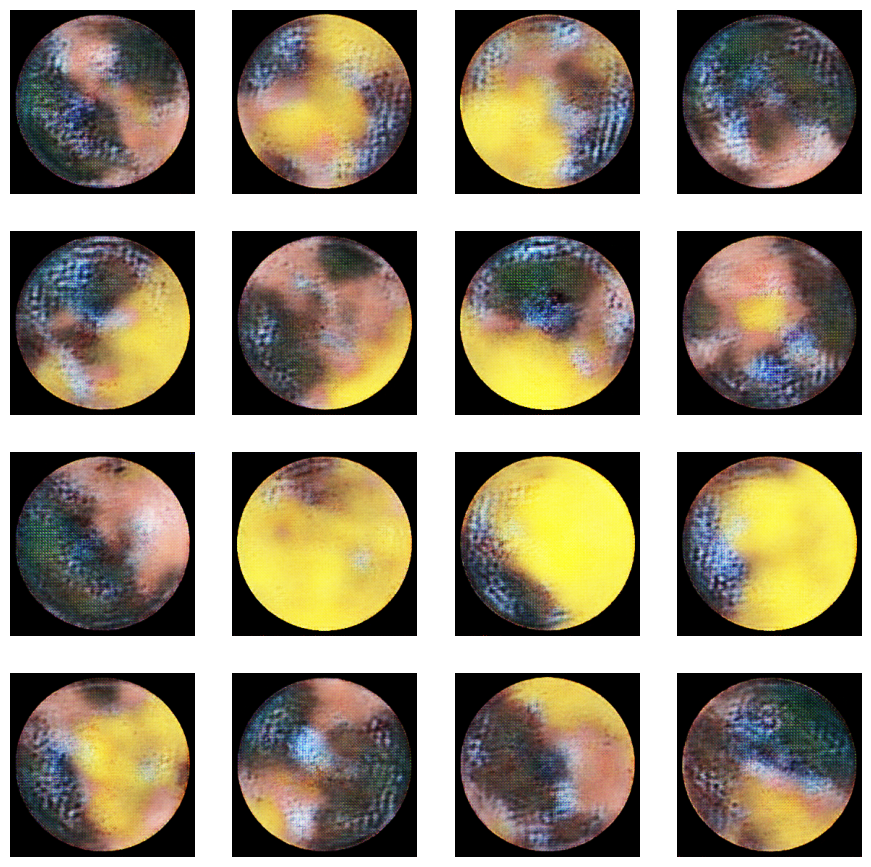

25/25 [==============================] - 467s 19s/step - d_loss: 4.5345 - g_loss: 3.2078
Epoch 2/250
25/25 [==============================] - 334s 13s/step - d_loss: 5.6823 - g_loss: 4.4515
Epoch 3/250
25/25 [==============================] - 329s 13s/step - d_loss: 5.2710 - g_loss: 3.8751
Epoch 4/250
25/25 [==============================] - 330s 13s/step - d_loss: 5.4519 - g_loss: 3.0032
Epoch 5/250
25/25 [==============================] - 325s 13s/step - d_loss: 4.7559 - g_loss: 3.8909
Epoch 6/250
25/25 [==============================] - 334s 13s/step - d_loss: 5.2383 - g_loss: 3.7087
Epoch 7/250
25/25 [==============================] - 349s 14s/step - d_loss: 4.9222 - g_loss: 3.8570
Epoch 8/250
25/25 [==============================] - 367s 15s/step - d_loss: 3.4687 - g_loss: 2.5778
Epoch 9/250
25/25 [==============================] - 391s 16s/step - d_loss: 5.6674 - g_loss: 3.5185
Epoch 10/250
25/25 [==============================] - 408s 16s/step - d_loss: 4.9209 - g_loss: 3.6693
E

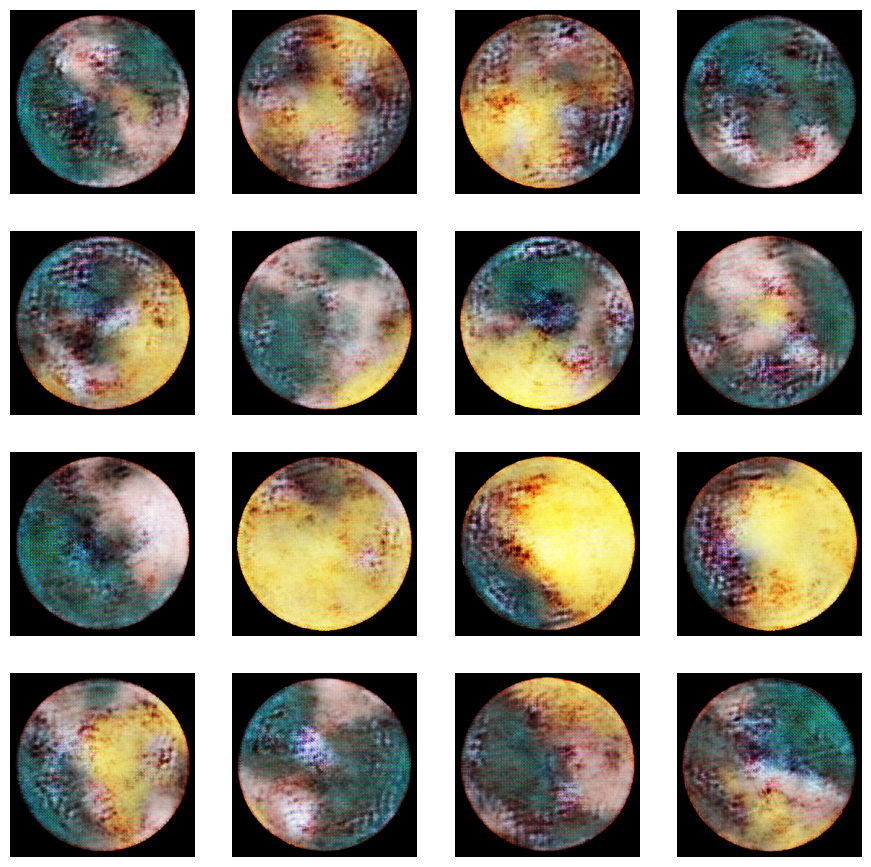

25/25 [==============================] - 437s 17s/step - d_loss: 4.7139 - g_loss: 2.1129
Epoch 12/250
25/25 [==============================] - 450s 18s/step - d_loss: 3.5796 - g_loss: 1.6609
Epoch 13/250
25/25 [==============================] - 462s 19s/step - d_loss: 2.7601 - g_loss: 3.5878
Epoch 14/250
25/25 [==============================] - 363s 15s/step - d_loss: 0.4965 - g_loss: 0.2101
Epoch 15/250
25/25 [==============================] - 343s 14s/step - d_loss: 0.7161 - g_loss: 0.2694
Epoch 16/250
25/25 [==============================] - 349s 14s/step - d_loss: 2.3959 - g_loss: 0.7566
Epoch 17/250
25/25 [==============================] - 346s 14s/step - d_loss: 3.9037 - g_loss: 3.2381
Epoch 18/250
25/25 [==============================] - 356s 14s/step - d_loss: 3.2547 - g_loss: 2.7201
Epoch 19/250
25/25 [==============================] - 368s 15s/step - d_loss: 2.8104 - g_loss: 1.3297
Epoch 20/250
25/25 [==============================] - 384s 15s/step - d_loss: 2.6881 - g_loss: 

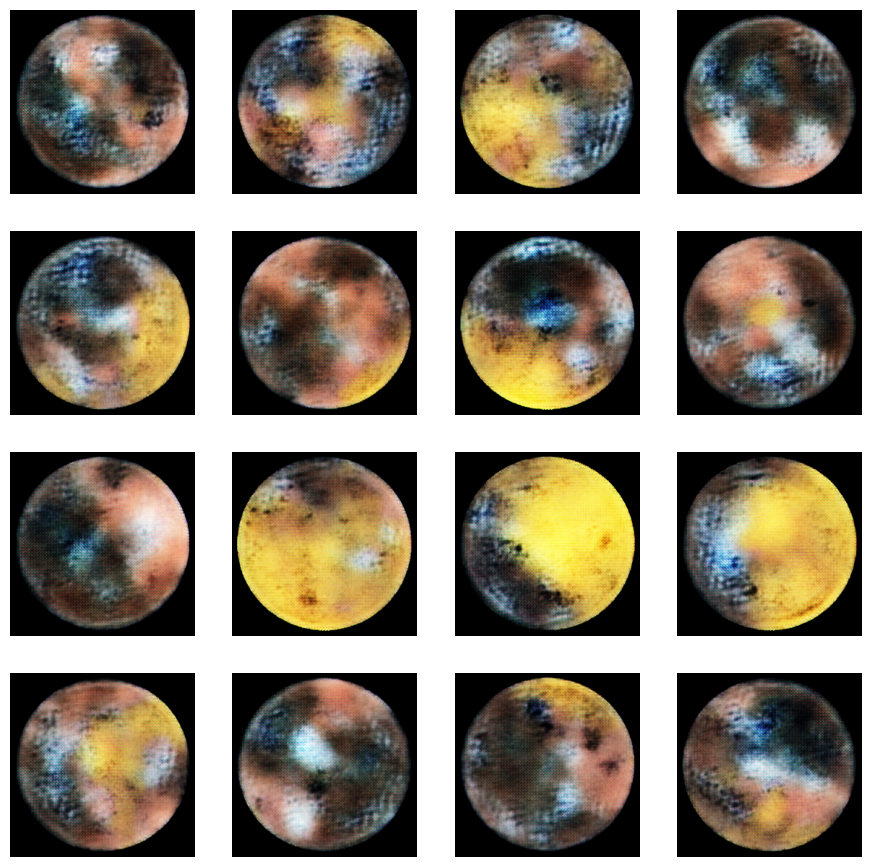

25/25 [==============================] - 404s 16s/step - d_loss: 5.0971 - g_loss: 3.7518
Epoch 22/250
25/25 [==============================] - 416s 17s/step - d_loss: 4.5917 - g_loss: 3.3582
Epoch 23/250
25/25 [==============================] - 330s 13s/step - d_loss: 4.3837 - g_loss: 2.3030
Epoch 24/250
25/25 [==============================] - 331s 13s/step - d_loss: 3.3998 - g_loss: 2.9724
Epoch 25/250
25/25 [==============================] - 336s 13s/step - d_loss: 4.8809 - g_loss: 3.2473
Epoch 26/250
25/25 [==============================] - 333s 13s/step - d_loss: 4.5095 - g_loss: 3.4886
Epoch 27/250
25/25 [==============================] - 343s 14s/step - d_loss: 3.4783 - g_loss: 2.5092
Epoch 28/250
25/25 [==============================] - 360s 14s/step - d_loss: 4.6475 - g_loss: 3.3527
Epoch 29/250
25/25 [==============================] - 376s 15s/step - d_loss: 2.8132 - g_loss: 0.4308
Epoch 30/250
25/25 [==============================] - 401s 16s/step - d_loss: 1.5917 - g_loss: 

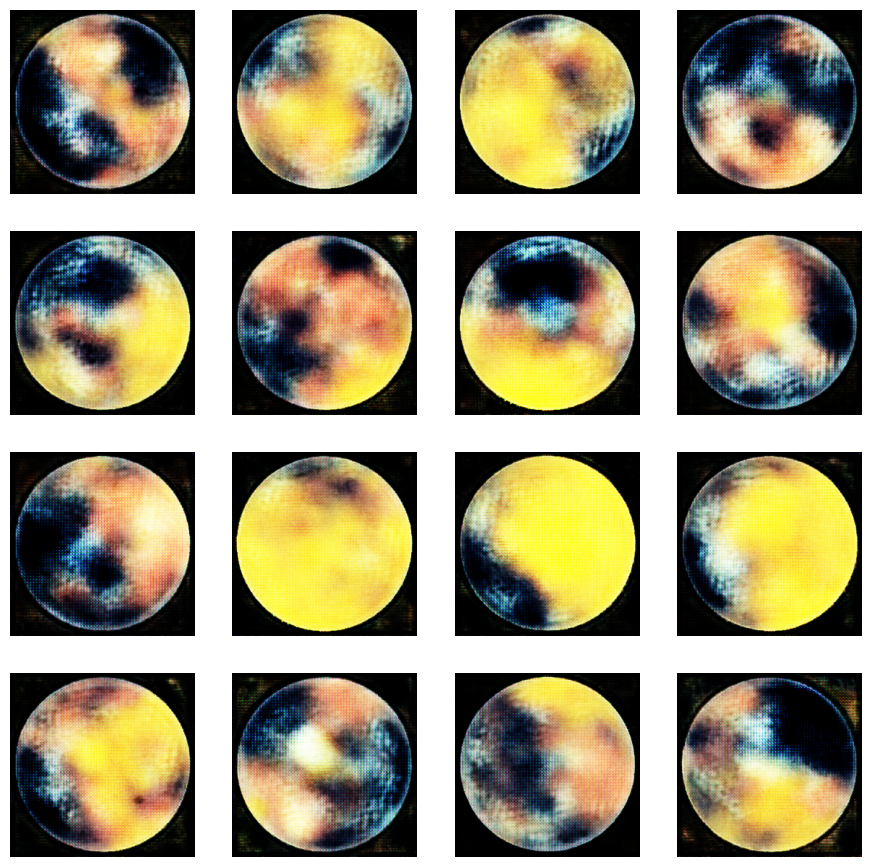

25/25 [==============================] - 416s 17s/step - d_loss: 1.3698 - g_loss: 1.9376
Epoch 32/250
25/25 [==============================] - 432s 17s/step - d_loss: 1.5508 - g_loss: 1.0576
Epoch 33/250
25/25 [==============================] - 442s 18s/step - d_loss: 1.4934 - g_loss: 0.4775
Epoch 34/250
25/25 [==============================] - 438s 18s/step - d_loss: 2.6953 - g_loss: 2.0106
Epoch 35/250
25/25 [==============================] - 445s 18s/step - d_loss: 3.8518 - g_loss: 3.9489
Epoch 36/250
25/25 [==============================] - 352s 14s/step - d_loss: 4.0523 - g_loss: 2.8260
Epoch 37/250
25/25 [==============================] - 353s 14s/step - d_loss: 3.9170 - g_loss: 3.5557
Epoch 38/250
25/25 [==============================] - 356s 14s/step - d_loss: 3.6095 - g_loss: 2.6814
Epoch 39/250
25/25 [==============================] - 349s 14s/step - d_loss: 4.8325 - g_loss: 3.7194
Epoch 40/250
25/25 [==============================] - 368s 15s/step - d_loss: 3.0278 - g_loss: 

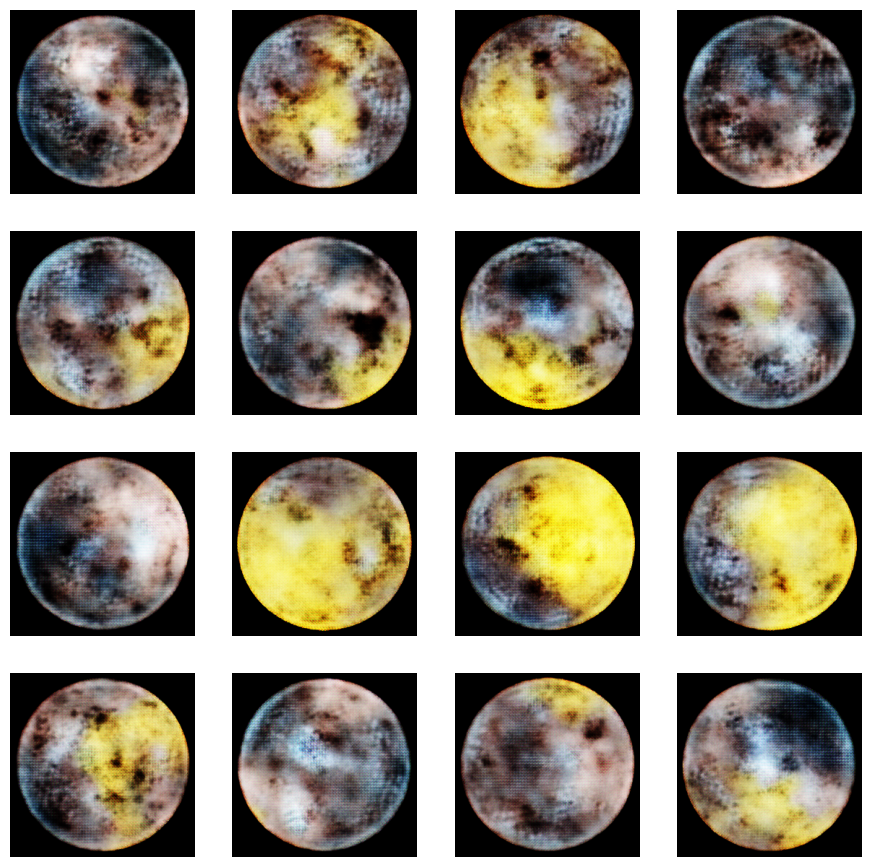

25/25 [==============================] - 382s 15s/step - d_loss: 1.4943 - g_loss: 0.1769
Epoch 42/250
25/25 [==============================] - 326s 13s/step - d_loss: 0.8765 - g_loss: 1.6907
Epoch 43/250
25/25 [==============================] - 320s 13s/step - d_loss: 0.1601 - g_loss: 0.2424
Epoch 44/250
25/25 [==============================] - 327s 13s/step - d_loss: 0.1443 - g_loss: 0.1159
Epoch 45/250
25/25 [==============================] - 326s 13s/step - d_loss: 0.6058 - g_loss: 0.4271
Epoch 46/250
25/25 [==============================] - 328s 13s/step - d_loss: 0.3451 - g_loss: 0.0797
Epoch 47/250
25/25 [==============================] - 346s 14s/step - d_loss: 3.0373 - g_loss: 2.8343
Epoch 48/250
25/25 [==============================] - 361s 14s/step - d_loss: 3.4471 - g_loss: 2.3888
Epoch 49/250
25/25 [==============================] - 378s 15s/step - d_loss: 1.9535 - g_loss: 0.5099
Epoch 50/250
25/25 [==============================] - 395s 16s/step - d_loss: 0.2289 - g_loss: 

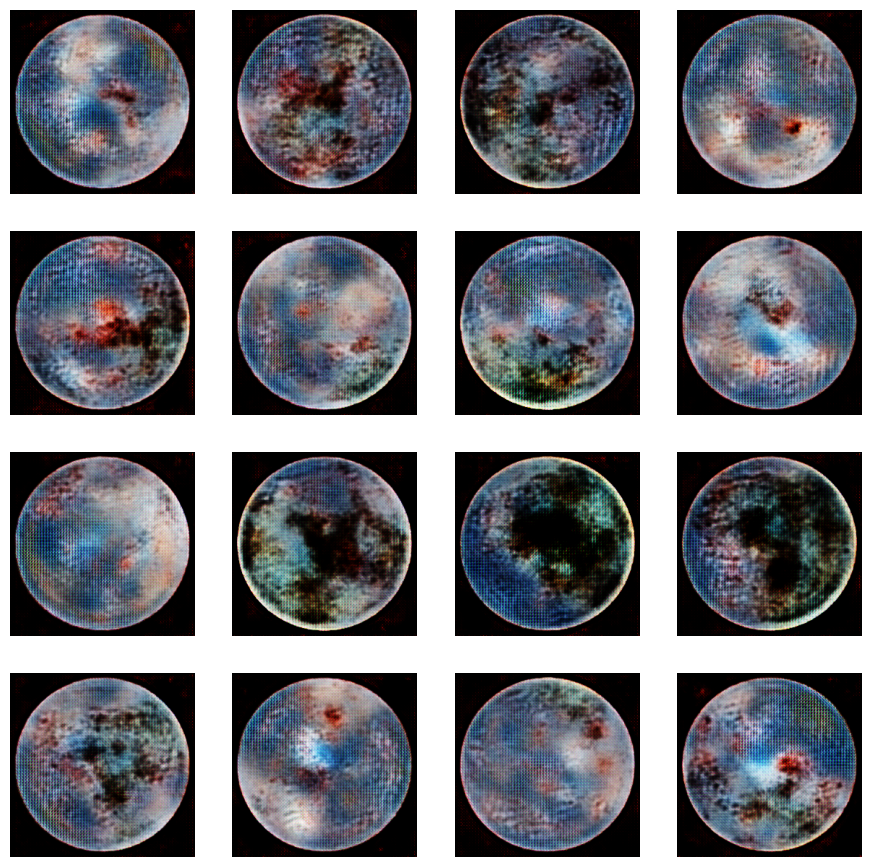

25/25 [==============================] - 416s 17s/step - d_loss: 0.6490 - g_loss: 1.1622
Epoch 52/250
25/25 [==============================] - 421s 17s/step - d_loss: 0.4805 - g_loss: 0.3521
Epoch 53/250
25/25 [==============================] - 431s 17s/step - d_loss: 0.1197 - g_loss: 0.4593
Epoch 54/250
25/25 [==============================] - 341s 14s/step - d_loss: 0.0766 - g_loss: 0.5579
Epoch 55/250
25/25 [==============================] - 343s 14s/step - d_loss: 0.2517 - g_loss: 1.0954
Epoch 56/250
25/25 [==============================] - 348s 14s/step - d_loss: 2.9824 - g_loss: 1.3164
Epoch 57/250
25/25 [==============================] - 342s 14s/step - d_loss: 2.7100 - g_loss: 3.3972
Epoch 58/250
25/25 [==============================] - 347s 14s/step - d_loss: 2.6117 - g_loss: 0.8936
Epoch 59/250
25/25 [==============================] - 363s 15s/step - d_loss: 0.8873 - g_loss: 0.5023
Epoch 60/250
25/25 [==============================] - 381s 15s/step - d_loss: 1.8355 - g_loss: 

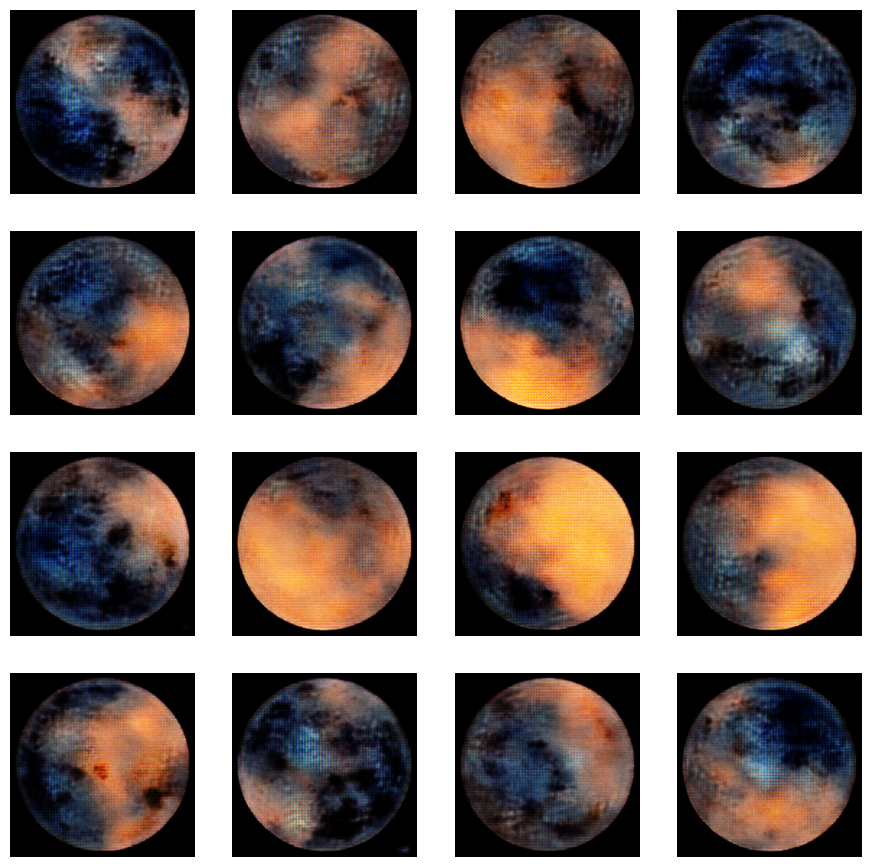

25/25 [==============================] - 399s 16s/step - d_loss: 1.9212 - g_loss: 3.3865
Epoch 62/250
25/25 [==============================] - 416s 17s/step - d_loss: 2.8707 - g_loss: 1.7398
Epoch 63/250
25/25 [==============================] - 343s 14s/step - d_loss: 2.5109 - g_loss: 1.8976
Epoch 64/250
25/25 [==============================] - 331s 13s/step - d_loss: 1.3389 - g_loss: 3.4888
Epoch 65/250
25/25 [==============================] - 336s 13s/step - d_loss: 0.1097 - g_loss: 0.1327
Epoch 66/250
25/25 [==============================] - 337s 13s/step - d_loss: 0.2983 - g_loss: 0.1419
Epoch 67/250
25/25 [==============================] - 339s 14s/step - d_loss: 0.7468 - g_loss: 0.6445
Epoch 68/250
25/25 [==============================] - 357s 14s/step - d_loss: 2.2559 - g_loss: 4.9570
Epoch 69/250
25/25 [==============================] - 374s 15s/step - d_loss: 3.9219 - g_loss: 2.6724
Epoch 70/250
25/25 [==============================] - 386s 15s/step - d_loss: 1.3329 - g_loss: 

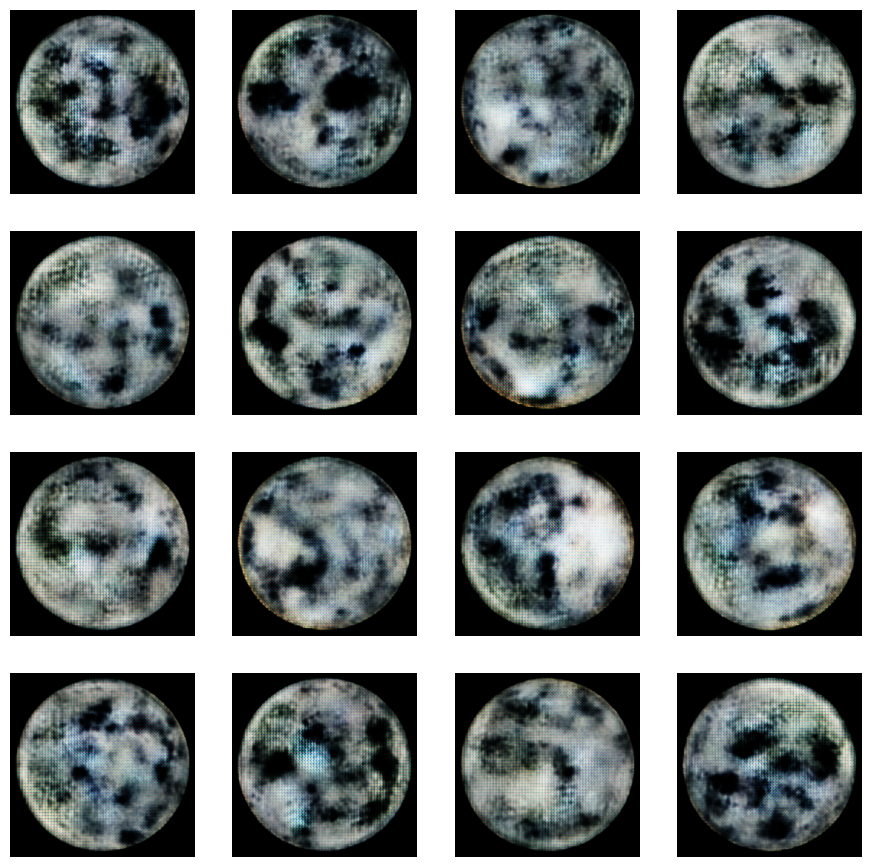

25/25 [==============================] - 420s 17s/step - d_loss: -0.4683 - g_loss: 0.0202
Epoch 72/250
25/25 [==============================] - 345s 14s/step - d_loss: 0.1261 - g_loss: 0.2278
Epoch 73/250
25/25 [==============================] - 344s 14s/step - d_loss: 0.6884 - g_loss: 0.2040
Epoch 74/250
25/25 [==============================] - 354s 14s/step - d_loss: 3.3905 - g_loss: 5.9248
Epoch 75/250
25/25 [==============================] - 364s 15s/step - d_loss: -0.0553 - g_loss: 0.0481
Epoch 76/250
25/25 [==============================] - 356s 14s/step - d_loss: 0.0994 - g_loss: 0.1514
Epoch 77/250
25/25 [==============================] - 353s 14s/step - d_loss: 1.7176 - g_loss: 3.1102
Epoch 78/250
25/25 [==============================] - 370s 15s/step - d_loss: 1.0981 - g_loss: 3.0965
Epoch 79/250
25/25 [==============================] - 392s 16s/step - d_loss: 0.2318 - g_loss: 1.1486
Epoch 80/250
25/25 [==============================] - 420s 17s/step - d_loss: 4.4108 - g_loss

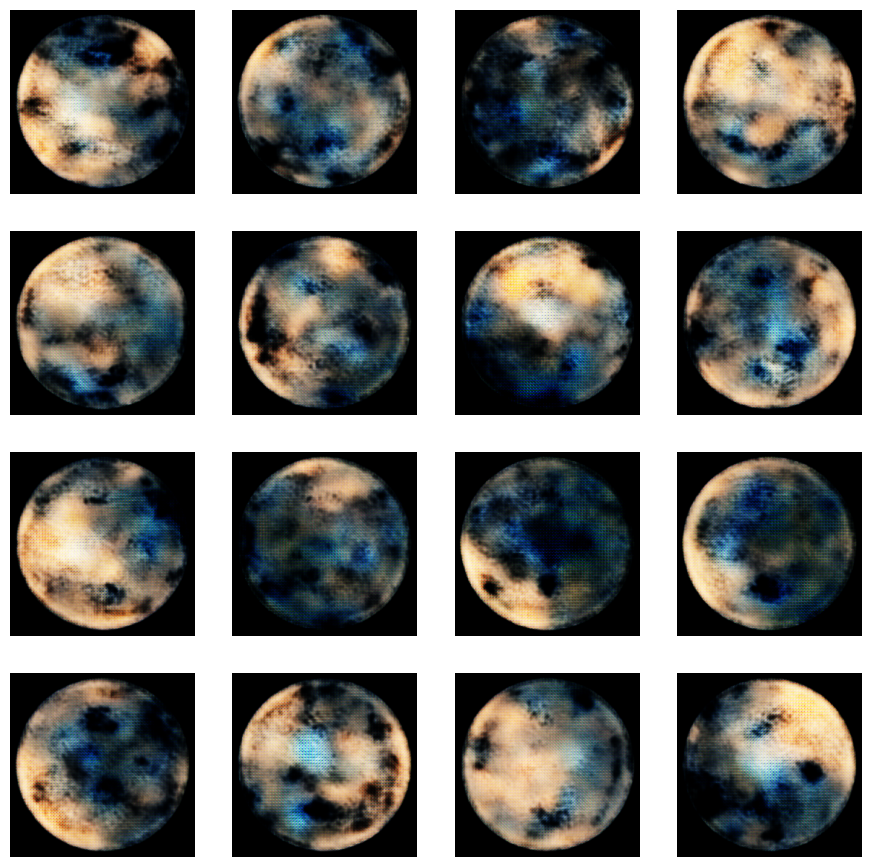

25/25 [==============================] - 435s 17s/step - d_loss: 2.0035 - g_loss: 1.8688
Epoch 82/250
25/25 [==============================] - 439s 18s/step - d_loss: 1.7475 - g_loss: 3.7760
Epoch 83/250
25/25 [==============================] - 438s 18s/step - d_loss: 2.2422 - g_loss: 3.9266
Epoch 84/250
25/25 [==============================] - 352s 14s/step - d_loss: 0.9741 - g_loss: 0.1437
Epoch 85/250
25/25 [==============================] - 358s 14s/step - d_loss: 0.1853 - g_loss: 0.0964
Epoch 86/250
25/25 [==============================] - 368s 15s/step - d_loss: 0.2089 - g_loss: 0.2660
Epoch 87/250
25/25 [==============================] - 370s 15s/step - d_loss: 1.0779 - g_loss: 1.2512
Epoch 88/250
25/25 [==============================] - 358s 14s/step - d_loss: 3.0182 - g_loss: 8.3468
Epoch 89/250
25/25 [==============================] - 368s 15s/step - d_loss: 1.8240 - g_loss: 1.8371
Epoch 90/250
25/25 [==============================] - 389s 16s/step - d_loss: 0.0410 - g_loss: 

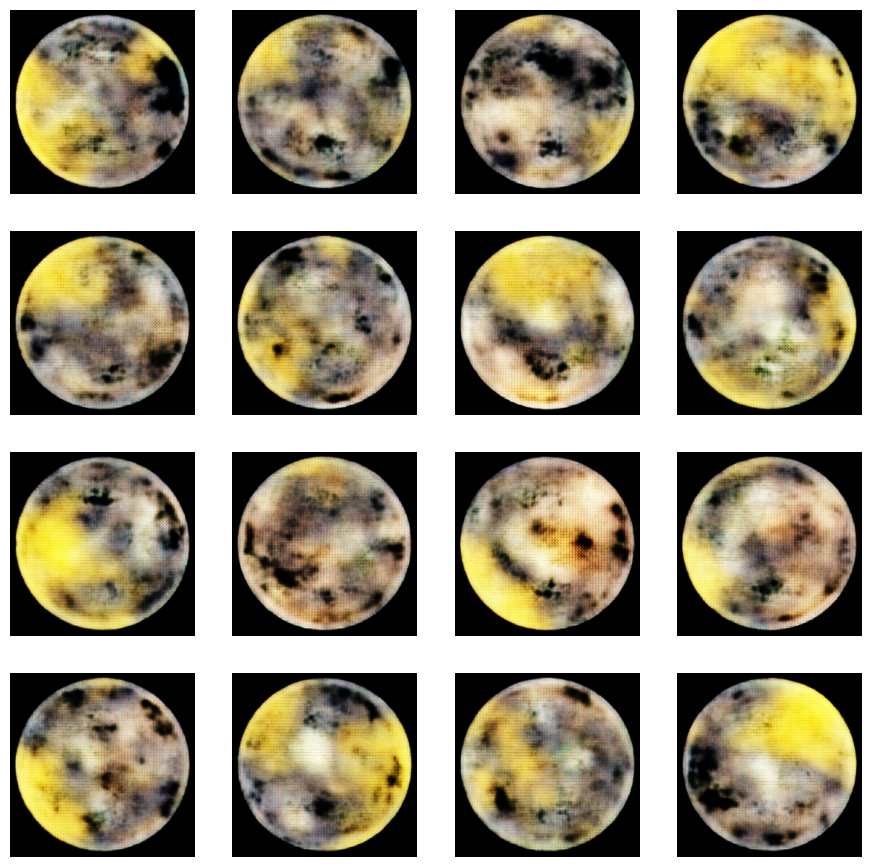

25/25 [==============================] - 413s 17s/step - d_loss: 0.3227 - g_loss: 0.9501
Epoch 92/250
25/25 [==============================] - 422s 17s/step - d_loss: 2.6251 - g_loss: 5.7747
Epoch 93/250
25/25 [==============================] - 365s 15s/step - d_loss: 2.8088 - g_loss: 4.7819
Epoch 94/250
25/25 [==============================] - 346s 14s/step - d_loss: 3.1221 - g_loss: 4.5886
Epoch 95/250
25/25 [==============================] - 347s 14s/step - d_loss: 3.0540 - g_loss: 3.0704
Epoch 96/250
25/25 [==============================] - 350s 14s/step - d_loss: -0.1203 - g_loss: 0.0187
Epoch 97/250
25/25 [==============================] - 351s 14s/step - d_loss: 0.7578 - g_loss: 2.8110
Epoch 98/250
25/25 [==============================] - 357s 14s/step - d_loss: 2.6289 - g_loss: 5.7070
Epoch 99/250
25/25 [==============================] - 374s 15s/step - d_loss: 0.4107 - g_loss: 0.2904
Epoch 100/250
25/25 [==============================] - 389s 16s/step - d_loss: 0.5314 - g_loss

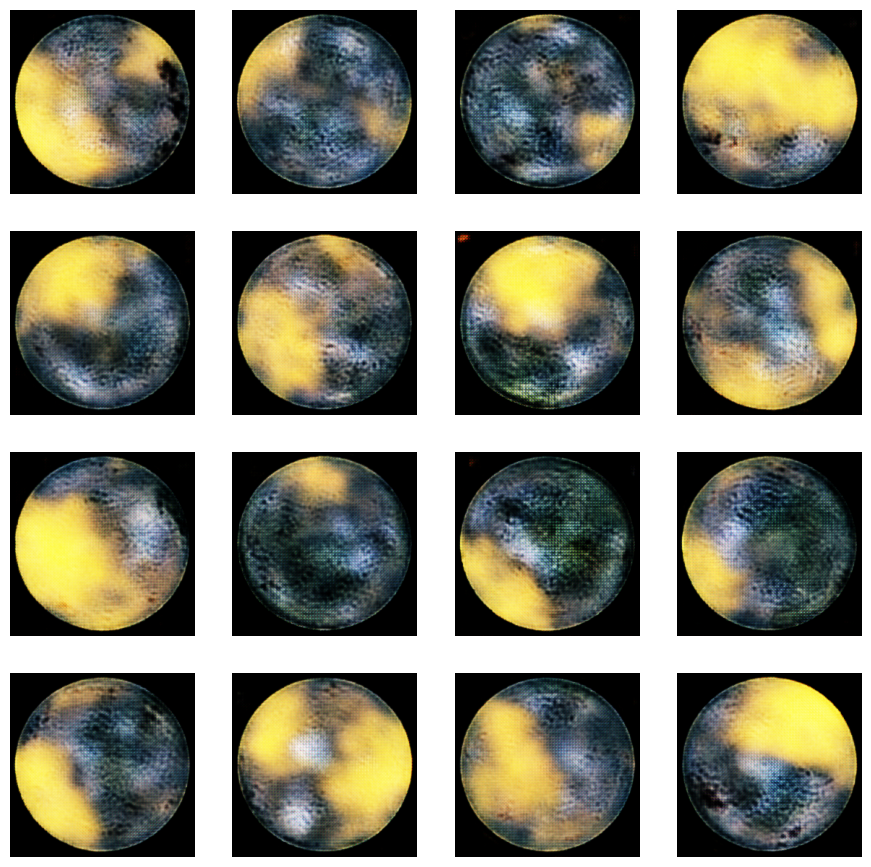

25/25 [==============================] - 407s 16s/step - d_loss: 2.7339 - g_loss: 3.2380
Epoch 102/250
25/25 [==============================] - 340s 14s/step - d_loss: 2.6503 - g_loss: 4.4046
Epoch 103/250
25/25 [==============================] - 332s 13s/step - d_loss: 1.7713 - g_loss: 3.6897
Epoch 104/250
25/25 [==============================] - 337s 13s/step - d_loss: 0.6263 - g_loss: 0.6729
Epoch 105/250
25/25 [==============================] - 342s 14s/step - d_loss: 2.9645 - g_loss: 5.8748
Epoch 106/250
25/25 [==============================] - 336s 13s/step - d_loss: 3.0756 - g_loss: 4.4978
Epoch 107/250
25/25 [==============================] - 341s 14s/step - d_loss: -0.0137 - g_loss: 0.0223
Epoch 108/250
25/25 [==============================] - 357s 14s/step - d_loss: 0.3213 - g_loss: 0.1879
Epoch 109/250
25/25 [==============================] - 373s 15s/step - d_loss: 0.8468 - g_loss: 0.8409
Epoch 110/250
25/25 [==============================] - 389s 16s/step - d_loss: 2.1852 

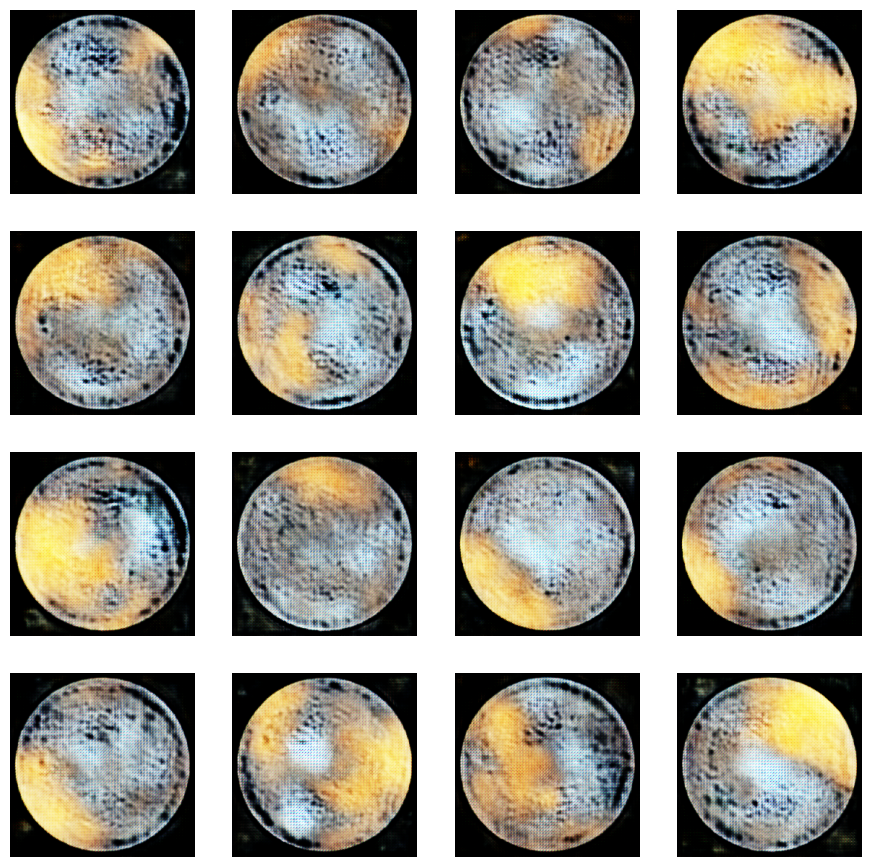

25/25 [==============================] - 407s 16s/step - d_loss: 0.2334 - g_loss: 1.3619
Epoch 112/250
25/25 [==============================] - 408s 16s/step - d_loss: 0.5225 - g_loss: 0.3360
Epoch 113/250
25/25 [==============================] - 424s 17s/step - d_loss: 1.2811 - g_loss: 3.3042
Epoch 114/250
25/25 [==============================] - 352s 14s/step - d_loss: 1.6087 - g_loss: 2.8264
Epoch 115/250
25/25 [==============================] - 348s 14s/step - d_loss: 3.5760 - g_loss: 4.1951
Epoch 116/250
25/25 [==============================] - 348s 14s/step - d_loss: 1.0984 - g_loss: 0.1662
Epoch 117/250
25/25 [==============================] - 364s 15s/step - d_loss: 0.5330 - g_loss: 1.0286
Epoch 118/250
25/25 [==============================] - 365s 15s/step - d_loss: 2.7081 - g_loss: 4.9655
Epoch 119/250
25/25 [==============================] - 361s 14s/step - d_loss: 2.4149 - g_loss: 5.5569
Epoch 120/250
25/25 [==============================] - 370s 15s/step - d_loss: 2.7446 -

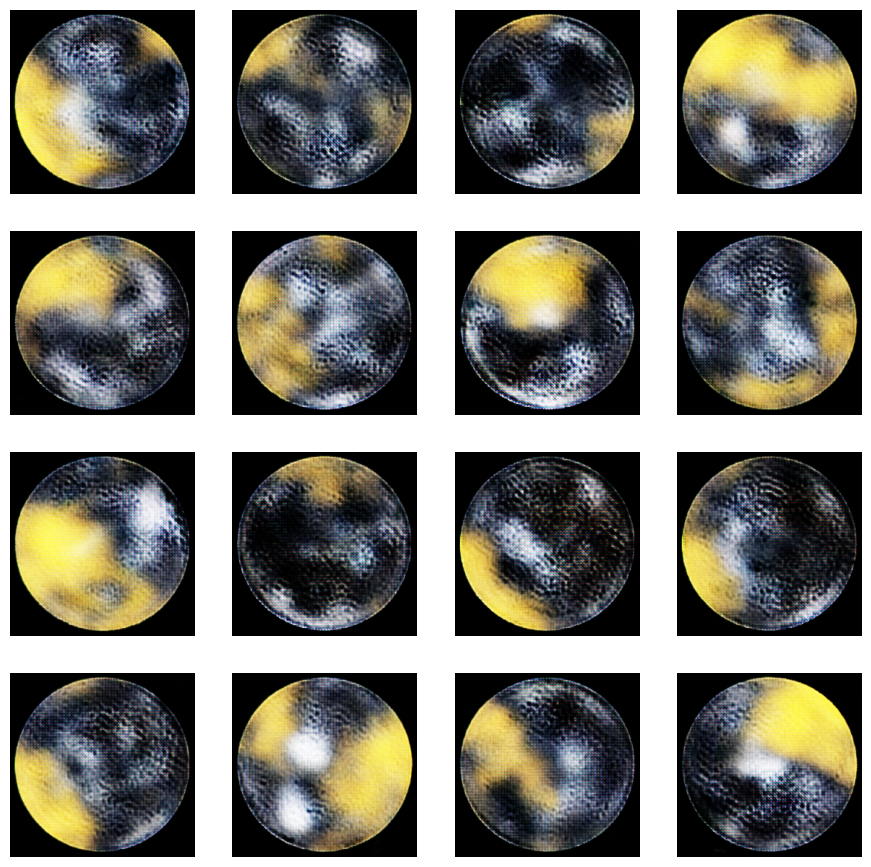

25/25 [==============================] - 382s 15s/step - d_loss: 2.3768 - g_loss: 2.8383
Epoch 122/250
25/25 [==============================] - 395s 16s/step - d_loss: 3.0773 - g_loss: 3.2818
Epoch 123/250
25/25 [==============================] - 424s 17s/step - d_loss: 1.8888 - g_loss: 3.1156
Epoch 124/250
25/25 [==============================] - 354s 14s/step - d_loss: 2.0875 - g_loss: 2.5993
Epoch 125/250
25/25 [==============================] - 354s 14s/step - d_loss: 2.6800 - g_loss: 6.2185
Epoch 126/250
25/25 [==============================] - 362s 14s/step - d_loss: 1.1462 - g_loss: 1.1492
Epoch 127/250
25/25 [==============================] - 364s 15s/step - d_loss: 2.5171 - g_loss: 5.1723
Epoch 128/250
25/25 [==============================] - 361s 14s/step - d_loss: 0.3790 - g_loss: 0.2059
Epoch 129/250
25/25 [==============================] - 370s 15s/step - d_loss: 1.7266 - g_loss: 3.7344
Epoch 130/250
25/25 [==============================] - 386s 15s/step - d_loss: -0.1305 

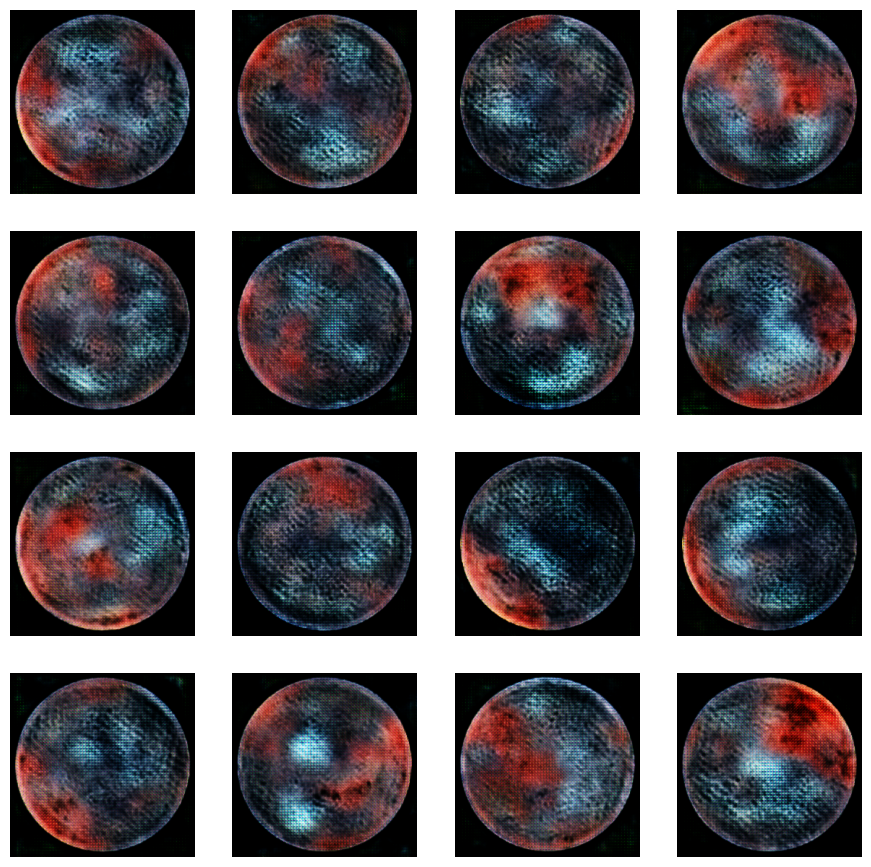

25/25 [==============================] - 405s 16s/step - d_loss: 2.0847 - g_loss: 2.1430
Epoch 132/250
25/25 [==============================] - 422s 17s/step - d_loss: 2.9078 - g_loss: 6.1207
Epoch 133/250
25/25 [==============================] - 359s 14s/step - d_loss: 2.3510 - g_loss: 4.4346
Epoch 134/250
25/25 [==============================] - 347s 14s/step - d_loss: 0.1121 - g_loss: 0.0283
Epoch 135/250
25/25 [==============================] - 350s 14s/step - d_loss: -0.1289 - g_loss: 0.0735
Epoch 136/250
25/25 [==============================] - 350s 14s/step - d_loss: 1.3270 - g_loss: 0.4241
Epoch 137/250
25/25 [==============================] - 347s 14s/step - d_loss: 0.5435 - g_loss: 0.6240
Epoch 138/250
25/25 [==============================] - 350s 14s/step - d_loss: 1.3876 - g_loss: 1.0842
Epoch 139/250
25/25 [==============================] - 365s 15s/step - d_loss: 2.0641 - g_loss: 1.9315
Epoch 140/250
25/25 [==============================] - 373s 15s/step - d_loss: 1.7404 

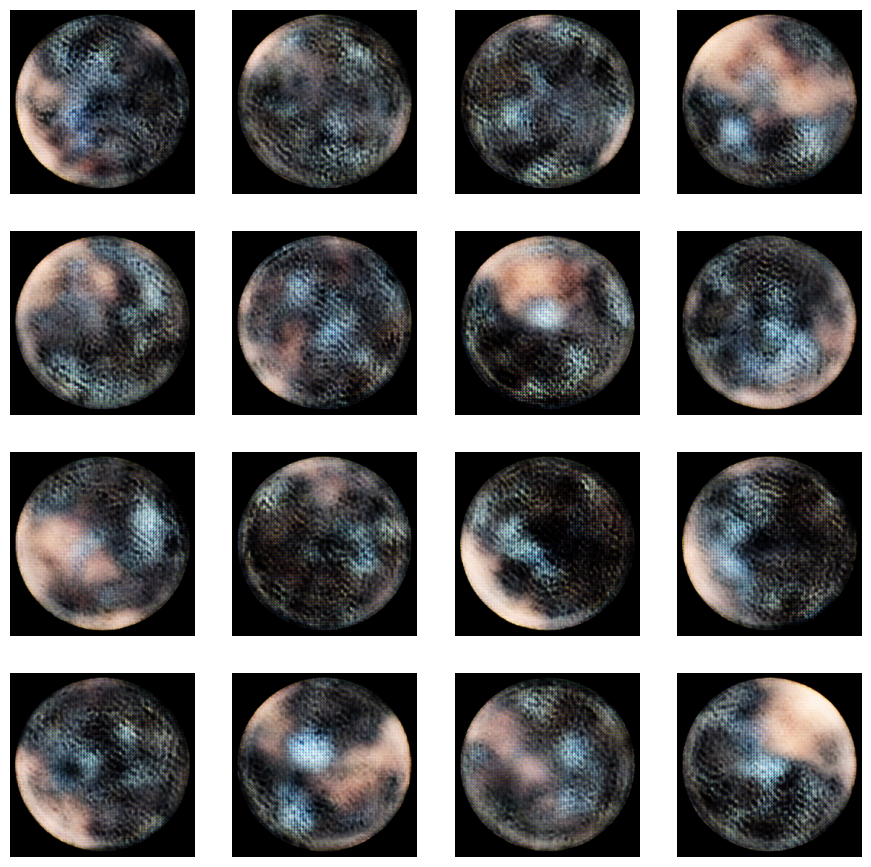

25/25 [==============================] - 388s 16s/step - d_loss: 2.4516 - g_loss: 4.1812
Epoch 142/250
25/25 [==============================] - 341s 14s/step - d_loss: 1.8351 - g_loss: 1.1669
Epoch 143/250
25/25 [==============================] - 335s 13s/step - d_loss: 0.4287 - g_loss: 1.0404
Epoch 144/250
25/25 [==============================] - 340s 14s/step - d_loss: 1.4198 - g_loss: 3.0098
Epoch 145/250
25/25 [==============================] - 345s 14s/step - d_loss: 0.1688 - g_loss: 0.8983
Epoch 146/250
25/25 [==============================] - 338s 14s/step - d_loss: 0.1889 - g_loss: 1.4097
Epoch 147/250
25/25 [==============================] - 343s 14s/step - d_loss: 2.1389 - g_loss: 5.3594
Epoch 148/250
25/25 [==============================] - 355s 14s/step - d_loss: 2.1474 - g_loss: 4.4905
Epoch 149/250
25/25 [==============================] - 359s 14s/step - d_loss: 2.4927 - g_loss: 3.7818
Epoch 150/250
25/25 [==============================] - 373s 15s/step - d_loss: 1.9035 -

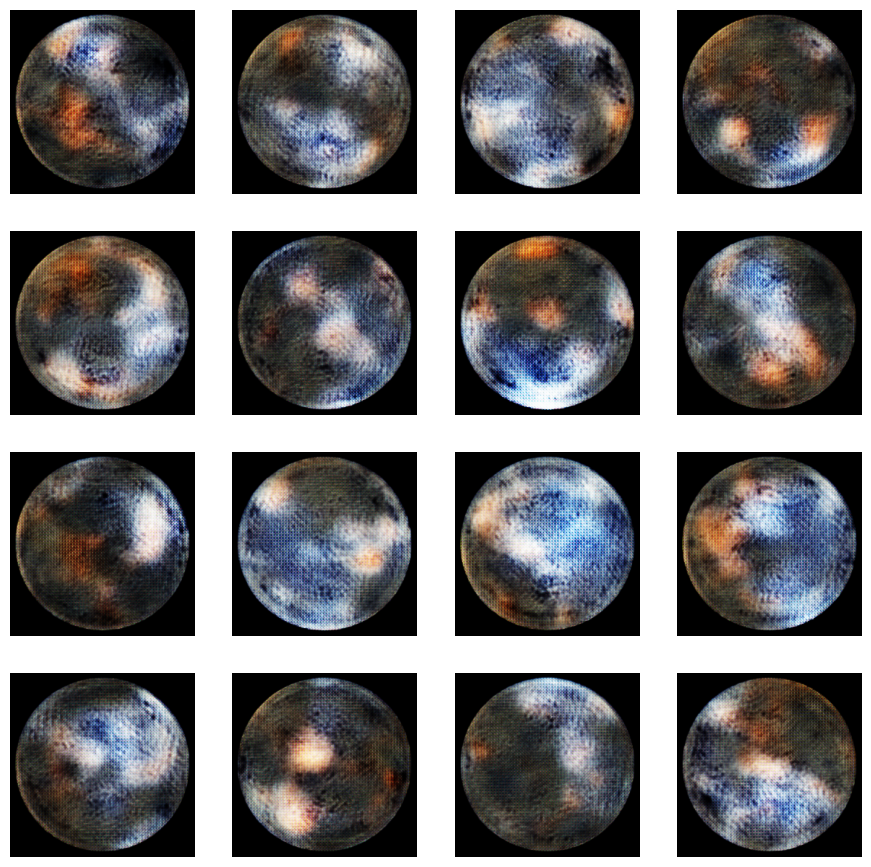

25/25 [==============================] - 398s 16s/step - d_loss: 2.1191 - g_loss: 6.9485
Epoch 152/250
25/25 [==============================] - 414s 17s/step - d_loss: 1.0164 - g_loss: 0.9524
Epoch 153/250
25/25 [==============================] - 432s 17s/step - d_loss: 0.6483 - g_loss: 0.4082
Epoch 154/250
25/25 [==============================] - 358s 14s/step - d_loss: -0.0053 - g_loss: 0.1546
Epoch 155/250
25/25 [==============================] - 349s 14s/step - d_loss: -0.1159 - g_loss: 0.1453
Epoch 156/250
25/25 [==============================] - 356s 14s/step - d_loss: 0.1537 - g_loss: 1.2069
Epoch 157/250
25/25 [==============================] - 362s 14s/step - d_loss: 0.9846 - g_loss: 2.0093
Epoch 158/250
25/25 [==============================] - 364s 15s/step - d_loss: -0.2877 - g_loss: 0.0485
Epoch 159/250
25/25 [==============================] - 378s 15s/step - d_loss: 1.9415 - g_loss: 3.2281
Epoch 160/250
25/25 [==============================] - 387s 15s/step - d_loss: 1.726

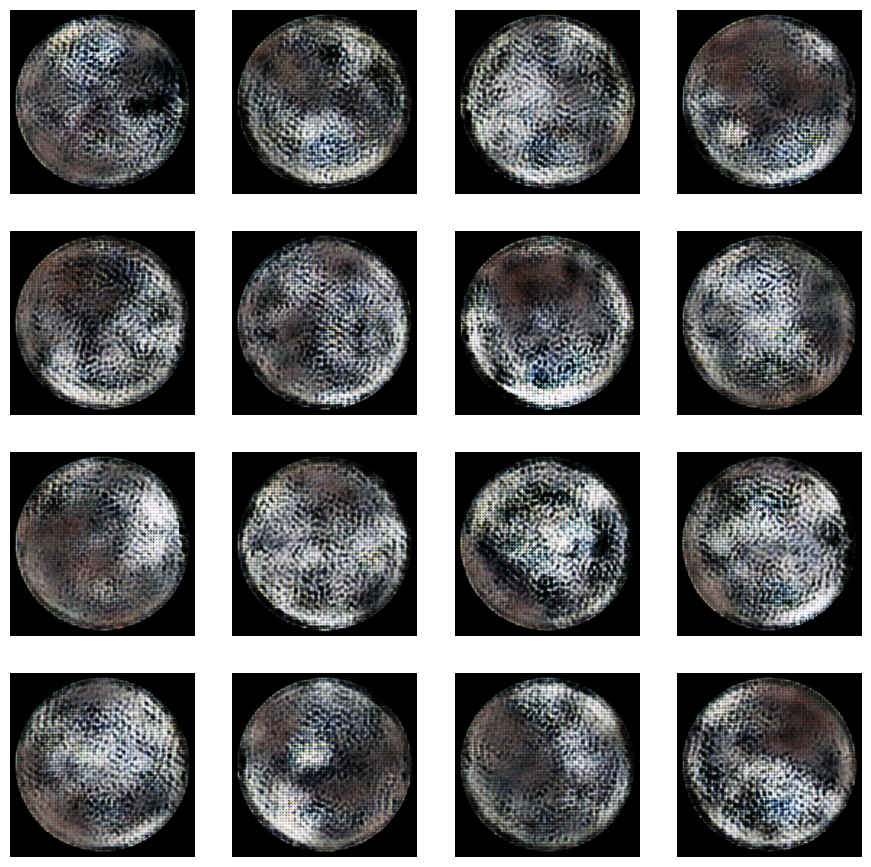

25/25 [==============================] - 398s 16s/step - d_loss: -0.8117 - g_loss: 9.0655e-04
Epoch 162/250
25/25 [==============================] - 413s 17s/step - d_loss: -1.0599 - g_loss: 0.0135
Epoch 163/250
25/25 [==============================] - 444s 18s/step - d_loss: 0.5637 - g_loss: 1.5525
Epoch 164/250
25/25 [==============================] - 362s 14s/step - d_loss: -0.4936 - g_loss: 0.0675
Epoch 165/250
25/25 [==============================] - 361s 14s/step - d_loss: 1.4006 - g_loss: 4.3011
Epoch 166/250
25/25 [==============================] - 372s 15s/step - d_loss: -0.0102 - g_loss: 0.0843
Epoch 167/250
25/25 [==============================] - 377s 15s/step - d_loss: 0.0211 - g_loss: 0.1414
Epoch 168/250
25/25 [==============================] - 368s 15s/step - d_loss: 0.1064 - g_loss: 0.2352
Epoch 169/250
25/25 [==============================] - 381s 15s/step - d_loss: 1.5493 - g_loss: 2.3355
Epoch 170/250
25/25 [==============================] - 408s 16s/step - d_loss: 

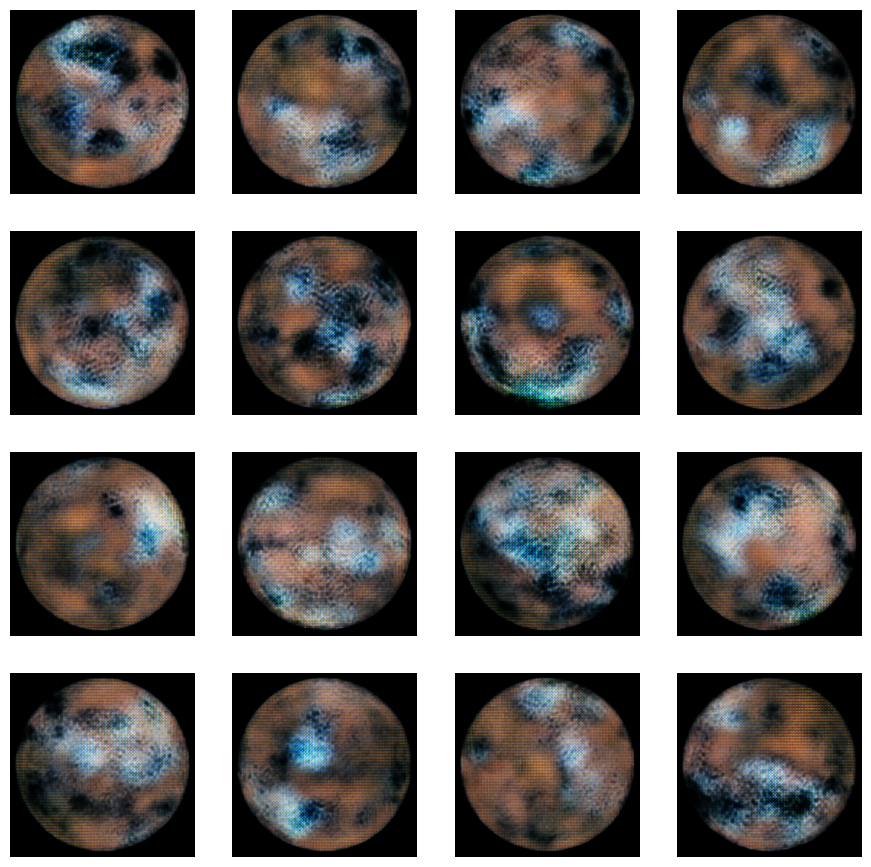

25/25 [==============================] - 432s 17s/step - d_loss: -0.1892 - g_loss: 0.0287
Epoch 172/250
25/25 [==============================] - 452s 18s/step - d_loss: -0.8118 - g_loss: 1.4401e-04
Epoch 173/250
25/25 [==============================] - 364s 15s/step - d_loss: -1.0018 - g_loss: 2.1776e-04
Epoch 174/250
25/25 [==============================] - 349s 14s/step - d_loss: -0.9897 - g_loss: 0.0154
Epoch 175/250
25/25 [==============================] - 348s 14s/step - d_loss: -0.9873 - g_loss: 0.0014
Epoch 176/250
25/25 [==============================] - 356s 14s/step - d_loss: -0.9492 - g_loss: 0.0252
Epoch 177/250
25/25 [==============================] - 356s 14s/step - d_loss: -0.4431 - g_loss: 0.1024
Epoch 178/250
25/25 [==============================] - 354s 14s/step - d_loss: -0.3830 - g_loss: 0.0121
Epoch 179/250
25/25 [==============================] - 367s 15s/step - d_loss: 1.0937 - g_loss: 0.1351
Epoch 180/250
25/25 [==============================] - 374s 15s/step - 

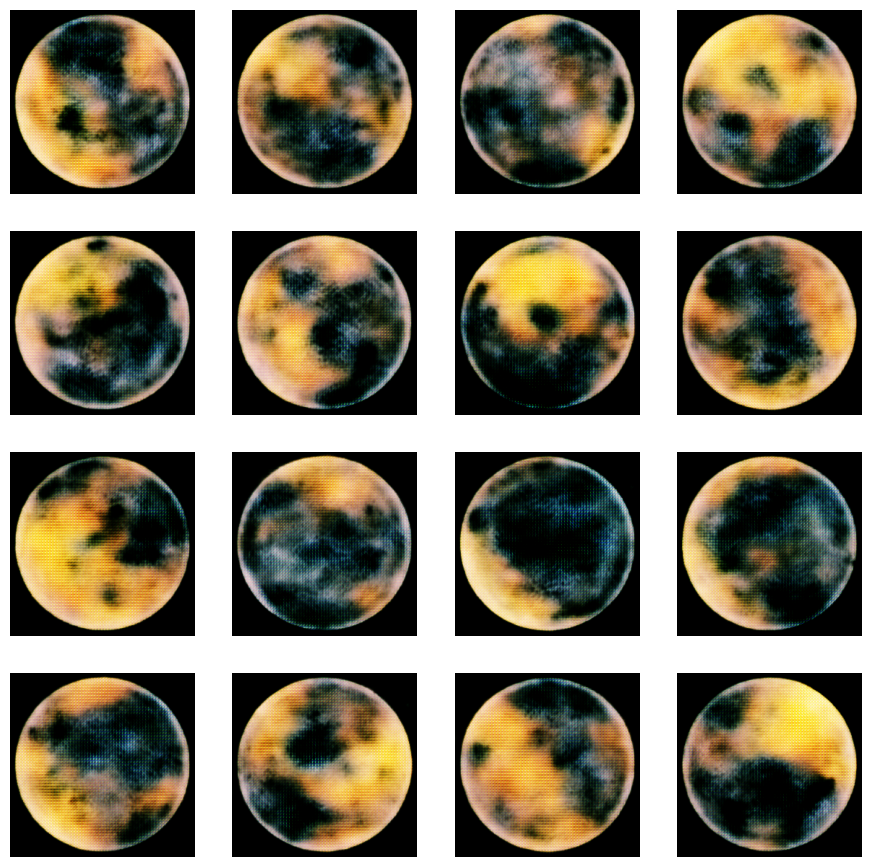

25/25 [==============================] - 396s 16s/step - d_loss: 0.9673 - g_loss: 2.8722
Epoch 182/250
25/25 [==============================] - 335s 13s/step - d_loss: -0.3232 - g_loss: 2.9138e-07
Epoch 183/250
25/25 [==============================] - 331s 13s/step - d_loss: -0.0726 - g_loss: 2.1436
Epoch 184/250
25/25 [==============================] - 340s 14s/step - d_loss: -0.4009 - g_loss: 0.4536
Epoch 185/250
25/25 [==============================] - 345s 14s/step - d_loss: -1.3943 - g_loss: 9.5258e-12
Epoch 186/250
25/25 [==============================] - 333s 13s/step - d_loss: -0.9321 - g_loss: 0.1764
Epoch 187/250
25/25 [==============================] - 345s 14s/step - d_loss: -1.0998 - g_loss: 0.0349
Epoch 188/250
25/25 [==============================] - 359s 14s/step - d_loss: -0.3610 - g_loss: 0.5160
Epoch 189/250
25/25 [==============================] - 371s 15s/step - d_loss: -0.6085 - g_loss: 0.1126
Epoch 190/250
25/25 [==============================] - 384s 15s/step - 

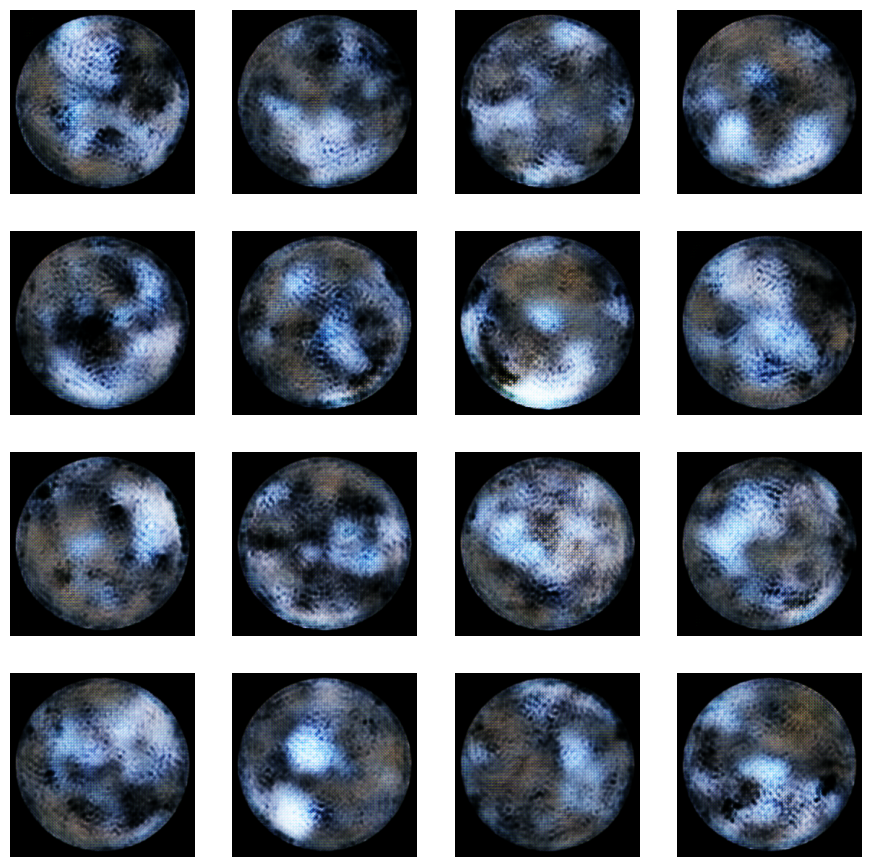

25/25 [==============================] - 415s 17s/step - d_loss: 1.6464 - g_loss: 2.6348
Epoch 192/250
25/25 [==============================] - 426s 17s/step - d_loss: -1.1462 - g_loss: 7.2716e-04
Epoch 193/250
25/25 [==============================] - 440s 18s/step - d_loss: -1.5996 - g_loss: 0.0409
Epoch 194/250
25/25 [==============================] - 352s 14s/step - d_loss: -2.1628 - g_loss: 0.0158
Epoch 195/250
25/25 [==============================] - 345s 14s/step - d_loss: -2.3351 - g_loss: 0.0117
Epoch 196/250
25/25 [==============================] - 354s 14s/step - d_loss: 3.4686 - g_loss: 0.2891
Epoch 197/250
25/25 [==============================] - 360s 14s/step - d_loss: -0.3794 - g_loss: 0.0460
Epoch 198/250
25/25 [==============================] - 350s 14s/step - d_loss: -0.5845 - g_loss: 0.0843
Epoch 199/250
25/25 [==============================] - 358s 14s/step - d_loss: 3.0336 - g_loss: 8.8400
Epoch 200/250
25/25 [==============================] - 373s 15s/step - d_loss

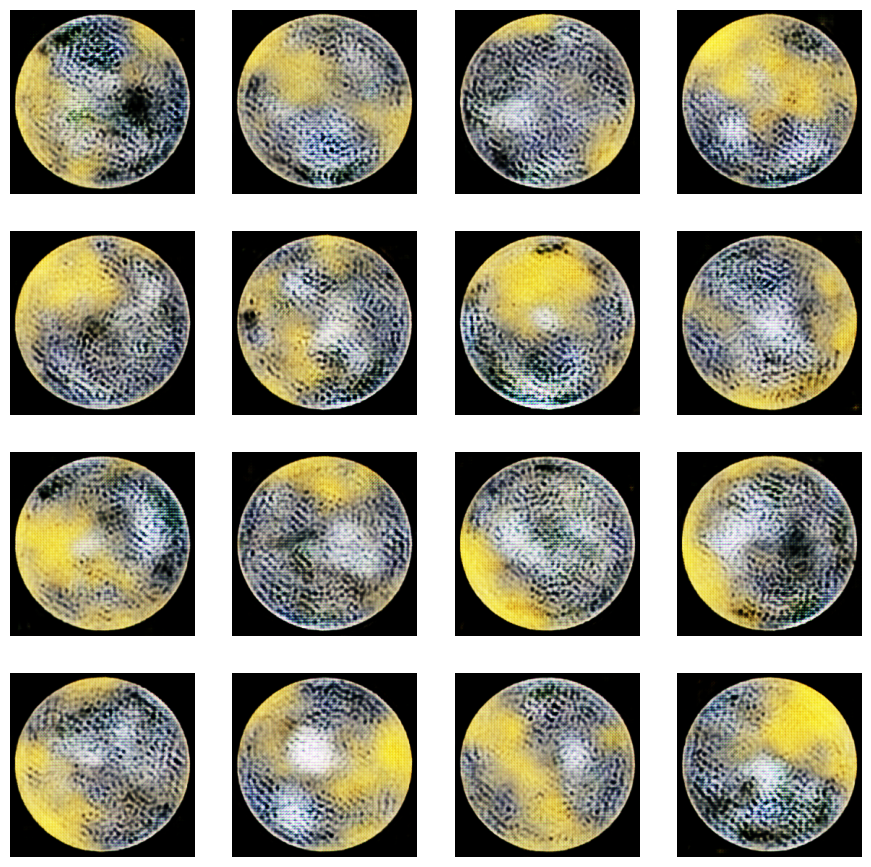

25/25 [==============================] - 388s 16s/step - d_loss: -0.4376 - g_loss: 0.0349
Epoch 202/250
25/25 [==============================] - 403s 16s/step - d_loss: -0.2890 - g_loss: 0.2049
Epoch 203/250
25/25 [==============================] - 434s 17s/step - d_loss: -0.4651 - g_loss: 0.0251
Epoch 204/250
25/25 [==============================] - 360s 14s/step - d_loss: 0.9483 - g_loss: 1.9463
Epoch 205/250
25/25 [==============================] - 358s 14s/step - d_loss: -0.1520 - g_loss: 0.0669
Epoch 206/250
25/25 [==============================] - 361s 14s/step - d_loss: -0.8316 - g_loss: 0.0258
Epoch 207/250
25/25 [==============================] - 365s 15s/step - d_loss: 2.0295 - g_loss: 5.7097
Epoch 208/250
25/25 [==============================] - 360s 14s/step - d_loss: -1.7303 - g_loss: 3.8237e-05
Epoch 209/250
25/25 [==============================] - 367s 15s/step - d_loss: -2.3437 - g_loss: 1.9580e-04
Epoch 210/250
25/25 [==============================] - 391s 16s/step - d

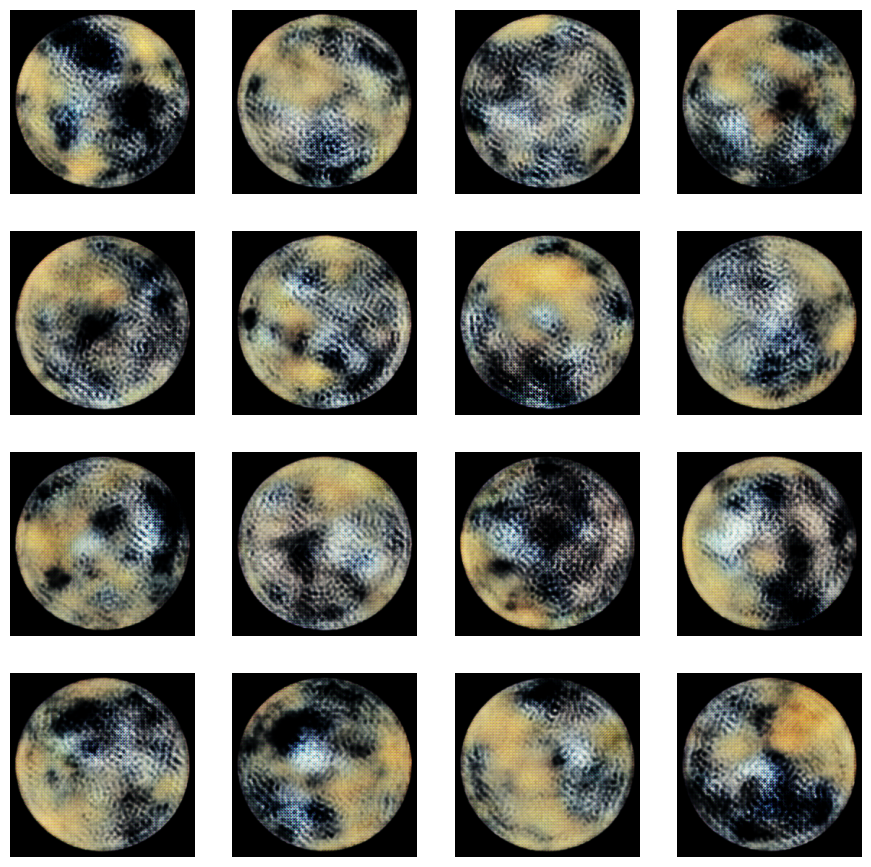

25/25 [==============================] - 415s 17s/step - d_loss: -1.7891 - g_loss: 0.0557
Epoch 212/250
25/25 [==============================] - 438s 18s/step - d_loss: -1.4787 - g_loss: 0.0167
Epoch 213/250
25/25 [==============================] - 352s 14s/step - d_loss: -0.3526 - g_loss: 0.5236
Epoch 214/250
25/25 [==============================] - 343s 14s/step - d_loss: 1.5841 - g_loss: 3.9906
Epoch 215/250
25/25 [==============================] - 345s 14s/step - d_loss: -1.0959 - g_loss: 0.0143
Epoch 216/250
25/25 [==============================] - 349s 14s/step - d_loss: -1.6344 - g_loss: 0.0235
Epoch 217/250
25/25 [==============================] - 347s 14s/step - d_loss: -2.3807 - g_loss: 0.0180
Epoch 218/250
25/25 [==============================] - 342s 14s/step - d_loss: -3.0268 - g_loss: 0.0126
Epoch 219/250
25/25 [==============================] - 351s 14s/step - d_loss: -3.9742 - g_loss: 0.0286
Epoch 220/250
25/25 [==============================] - 365s 15s/step - d_loss: 

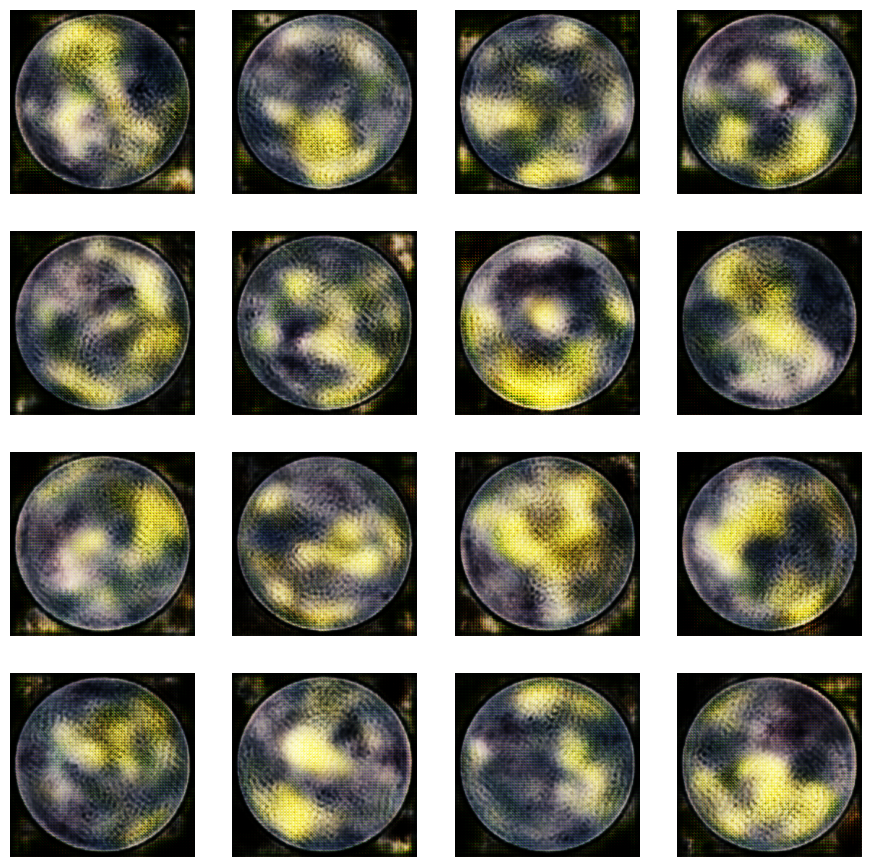

25/25 [==============================] - 382s 15s/step - d_loss: -1.6814 - g_loss: 0.0062
Epoch 222/250
25/25 [==============================] - 342s 14s/step - d_loss: -0.5977 - g_loss: 3.4131
Epoch 223/250
25/25 [==============================] - 333s 13s/step - d_loss: 4.8754 - g_loss: 9.3589
Epoch 224/250
25/25 [==============================] - 338s 14s/step - d_loss: -3.5761 - g_loss: 2.1281e-11
Epoch 225/250
25/25 [==============================] - 345s 14s/step - d_loss: -5.0339 - g_loss: 1.4876e-05
Epoch 226/250
25/25 [==============================] - 338s 14s/step - d_loss: -7.7406 - g_loss: 0.0033
Epoch 227/250
25/25 [==============================] - 340s 14s/step - d_loss: -11.8150 - g_loss: 0.0097
Epoch 228/250
25/25 [==============================] - 352s 14s/step - d_loss: -11.9372 - g_loss: 0.0782
Epoch 229/250
25/25 [==============================] - 367s 15s/step - d_loss: 13.9386 - g_loss: 0.9047
Epoch 230/250
25/25 [==============================] - 379s 15s/step 

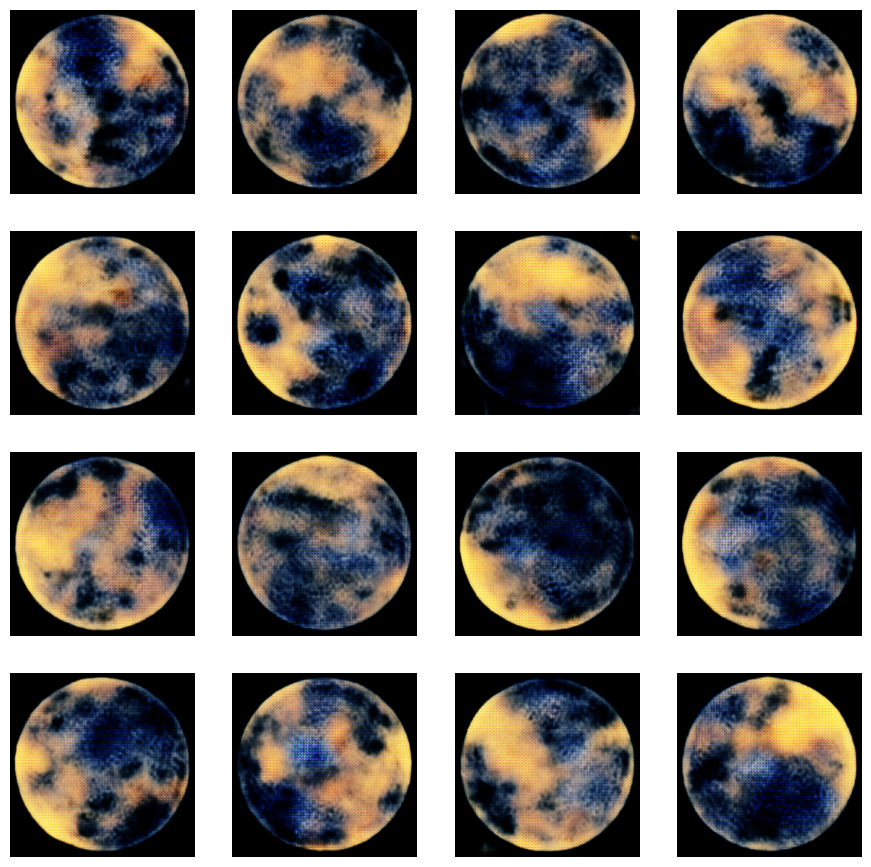

25/25 [==============================] - 409s 16s/step - d_loss: -1.0713 - g_loss: 0.4940
Epoch 232/250
25/25 [==============================] - 422s 17s/step - d_loss: 8.7996 - g_loss: 19.9951
Epoch 233/250
25/25 [==============================] - 443s 18s/step - d_loss: -0.7937 - g_loss: 0.1380
Epoch 234/250
25/25 [==============================] - 356s 14s/step - d_loss: -1.0982 - g_loss: 0.2817
Epoch 235/250
25/25 [==============================] - 347s 14s/step - d_loss: -1.2729 - g_loss: 0.1832
Epoch 236/250
25/25 [==============================] - 355s 14s/step - d_loss: -1.6289 - g_loss: 0.0440
Epoch 237/250
25/25 [==============================] - 358s 14s/step - d_loss: -0.2559 - g_loss: 0.6441
Epoch 238/250
25/25 [==============================] - 347s 14s/step - d_loss: -0.1923 - g_loss: 3.6547
Epoch 239/250
25/25 [==============================] - 352s 14s/step - d_loss: 16.5615 - g_loss: 23.4817
Epoch 240/250
25/25 [==============================] - 369s 15s/step - d_loss

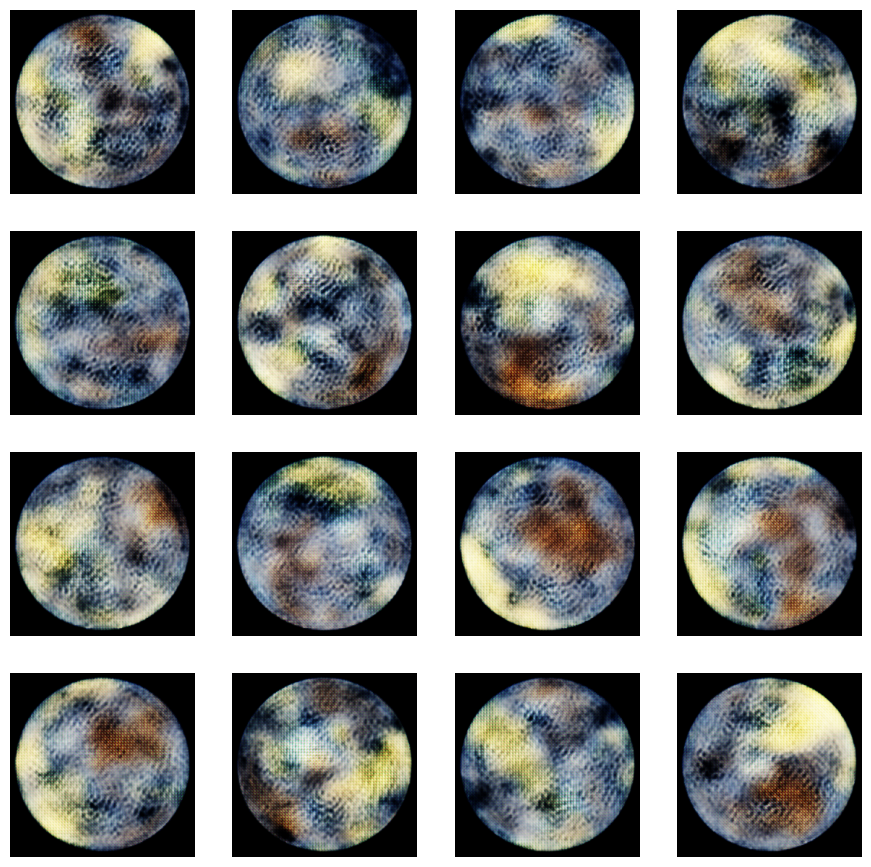

25/25 [==============================] - 380s 15s/step - d_loss: -1.2739 - g_loss: 0.5465
Epoch 242/250
25/25 [==============================] - 395s 16s/step - d_loss: 0.0843 - g_loss: 0.6525
Epoch 243/250
25/25 [==============================] - 423s 17s/step - d_loss: -0.3374 - g_loss: 0.3920
Epoch 244/250
25/25 [==============================] - 366s 15s/step - d_loss: 0.1820 - g_loss: 0.2123
Epoch 245/250
25/25 [==============================] - 361s 14s/step - d_loss: 0.7984 - g_loss: 4.5047
Epoch 246/250
25/25 [==============================] - 366s 15s/step - d_loss: 1.6418 - g_loss: 2.2193
Epoch 247/250
25/25 [==============================] - 373s 15s/step - d_loss: 0.4786 - g_loss: 0.7678
Epoch 248/250
25/25 [==============================] - 365s 15s/step - d_loss: 0.1424 - g_loss: 1.0797
Epoch 249/250
25/25 [==============================] - 366s 15s/step - d_loss: 0.2067 - g_loss: 1.0570
Epoch 250/250
25/25 [==============================] - 383s 15s/step - d_loss: 1.0045

In [22]:
NUM_EPOCHS = 250 # number of epochs
SESJA = 4
dcgan.fit(train_images, epochs=NUM_EPOCHS, callbacks=[GANMonitor(num_img=16, latent_dim=LATENT_DIM)])

# Deployment

Tworzenie gifa z wyników generowania planet w każdej epoce

In [1]:
import glob
import contextlib
from PIL import Image

# filepaths
fp_in = "./results_256_v2/*.jpg"
fp_out = "./results_256_v2/epochs256_v2.gif"

# use exit stack to automatically close opened images
with contextlib.ExitStack() as stack:

    # lazily load images
    imgs = (stack.enter_context(Image.open(f))
            for f in sorted(glob.glob(fp_in)))

    # extract  first image from iterator
    img = next(imgs)

    # https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
    img.save(fp=fp_out, format='GIF', append_images=imgs,
             save_all=True, duration=1, loop=0)

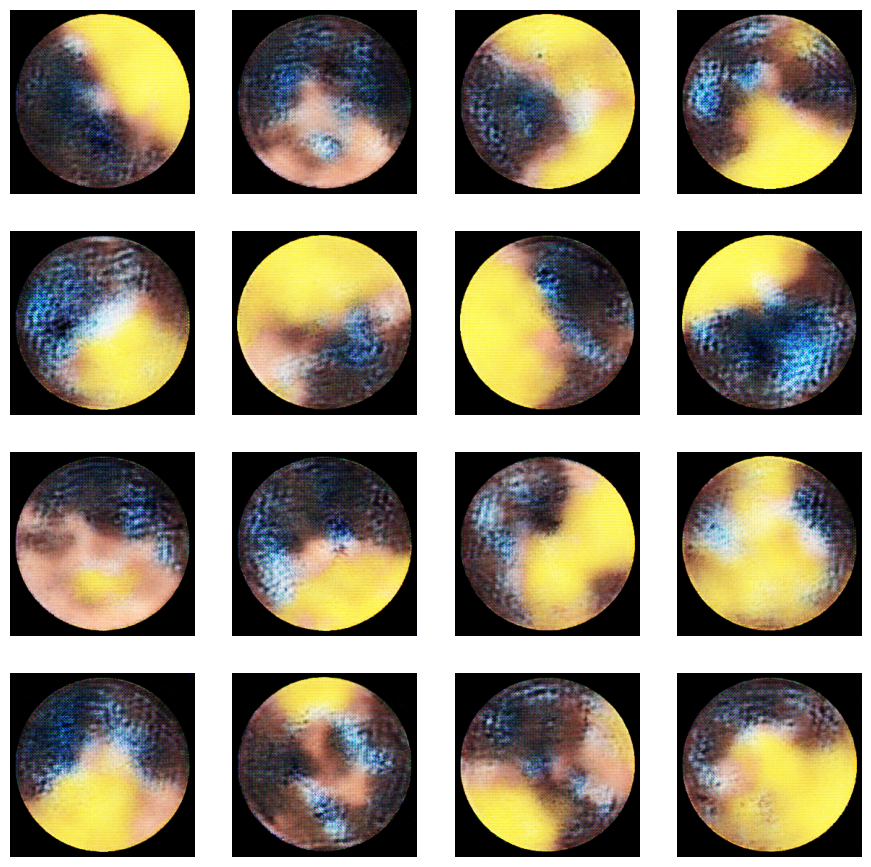

In [20]:
# generowanie nowej planety
num_imgs = 16
latent_dim = 100
seed = tf.random.normal([num_imgs, latent_dim])

generated_images = generator(seed)
generated_images = (generated_images * 127.5) + 127.5
generated_images.numpy()

fig = plt.figure(figsize=(11, 11))
for i in range(num_imgs):
    plt.subplot(4, 4, i+1)
    img = keras.utils.array_to_img(generated_images[i]) 
    plt.imshow(img)
    plt.axis('off')
plt.show()
plt.close(fig)